In [1]:
# This is the first notebook made for this project. When this got too big, I
# started two new notebooks, "Zelda Adventure Asset Extractor" and
# "Zelda Adventure Game Data".

import struct
import json
import datetime
import math

# Takes as input the files produced by the Mame CDH Format Decompressor notebook

filename = "Zeldas Adventure (Europe).dat"
#filename = "Link - The Faces of Evil (Europe).dat"
#filename = "Zelda - The Wand of Gamelon (USA).dat"

with open(filename, "rb") as f:
    gameFile = f.read()
print("Loaded")

Loaded


In [2]:
import cdi_filesystem

import tqdm
print(tqdm.tqdm_notebook)

import importlib
importlib.reload(cdi_filesystem)

cdi_filesystem.loadCdiImageFile(filename)

<function tqdm_notebook at 0x0000029451F8C2C0>


parsing file:   0%|          | 0/1 [00:00<?, ?it/s]

building sectors:   0%|          | 0/220024 [00:00<?, ?it/s]

building files:   0%|          | 0/12 [00:00<?, ?it/s]

searching files for modules:   0%|          | 0/12 [00:00<?, ?it/s]

searching cdi_zelda for modules:   0%|          | 0/65 [00:00<?, ?it/s]

locating module name:   0%|          | 0/62 [00:00<?, ?it/s]

locating module name:   0%|          | 0/3 [00:00<?, ?it/s]

locating module name:   0%|          | 0/1 [00:00<?, ?it/s]

locating module name:   0%|          | 0/2 [00:00<?, ?it/s]

In [3]:
class StructStream:
    def __init__(self, data, cursor = 0, endianPrefix = None, simpleReturn = True):
        self._data = data
        self._cursor = cursor
        self._prefix = endianPrefix
        self._simplify = simpleReturn
        
        self._peekAmount = 0
    
    def __len__(self):
        return max(0, len(self._data) - self._cursor)

    def __str__(self):
        return str(self._data[self._cursor:])
    
    def __repr__(self):
        ret = "StructStream(" + repr(self.peekRaw(30))
        if len(self) > 30:
            ret += "..."
        ret += ", cursor=" + str(min(self._cursor, len(self._data)))
        if self._prefix:
            ret += ", endianPrefix=" + self._prefix
        return ret + ")"
    
    def peekRaw(self, count, fillZeros = False):
        ret = self._data[self._cursor:self._cursor + count]
        if fillZeros and len(ret) < count:
            ret += b'0' * (count - len(ret))
        self._peekAmount = count
        return ret
    
    def takeRaw(self, count, fillZeros = False):
        ret = self.peekRaw(count, fillZeros)
        self._cursor += count
        return ret
    
    def peek(self, formatStr, fillZeros = False):
        if len(formatStr) == 0:
            return ()
        if self._prefix and formatStr[0] not in "@=<>!":
            formatStr = self._prefix + formatStr
        retTuple = struct.unpack(formatStr, self.peekRaw(struct.calcsize(formatStr), fillZeros))
        if self._simplify and len(retTuple) == 1:
            return retTuple[0]
        else:
            return retTuple
    
    def take(self, formatStr, fillZeros = False):
        ret = self.peek(formatStr, fillZeros)
        self._cursor += self._peekAmount
        return ret
    
    def peekAll(self):
        return self.peekRaw(len(self))
    
    def takeAll(self):
        return self.takeRaw(len(self))
    
    # Note: Supports chaining!
    # Note: Supports negative counts!
    def skip(self, count):
        self._cursor = max(0, self._cursor + count)
        return self
    
    # Copies all data, including already visited data.
    def copy(self):
        return StructStream(self._data, cursor=self._cursor, endianPrefix=self._prefix, simpleReturn=self._simplify)
    
    # Copies only remaining data.
    def fork(self):
        return StructStream(self._data[self._cursor:], endianPrefix==self._prefix, simpleReturn=self._simplify)
    
    def peekFork(self, count, fillZeros = False):
        data = self.peekRaw(count, fillZeros)
        return StructStream(data, endianPrefix=self._prefix, simpleReturn=self._simplify)
    
    def takeFork(self, count, fillZeros = False):
        data = self.takeRaw(count, fillZeros)
        return StructStream(data, endianPrefix=self._prefix, simpleReturn=self._simplify)
    
    def peekNullTermString(self, includeTerminator = False):
        self._cursor = max(self._cursor, 0)
        try:
            ret = self.peekRaw(self._data.index(0, self._cursor) - self._cursor + 1)
            if includeTerminator:
                return ret
            else:
                return ret[:-1]
        except ValueError:
            ret = self._data[self._cursor:]
            self._peekAmount = len(ret)
            return ret
    
    def takeNullTermString(self, includeTerminator = False):
        ret = self.peekNullTermString(includeTerminator=includeTerminator)
        self._cursor += self._peekAmount
        return ret

test = StructStream(b'hello\x00world\x00partial')
t = test.peekNullTermString()
assert t == b'hello', t
t = test.takeNullTermString()
assert t == b'hello', t
t = test.takeNullTermString()
assert t == b'world', t
t = test.takeNullTermString()
assert t == b'partial', t
t = test.takeNullTermString()
assert t == b''
del t
del test
print("All tests passed")

All tests passed


In [4]:
def parseFile(file):
    offset, strlen = struct.unpack("QQ", gameFile[:16])
    blob = gameFile[offset:]
    metadata = json.loads(gameFile[16:16 + strlen].decode('utf-8'))

    for sector in metadata["sectors"]:
        sector["data"] = blob[sector["dataOffset"]:sector["dataOffset"] + sector["dataLength"]]
    
    return metadata

gameRawData = parseFile(gameFile)
print(repr(gameRawData["sectors"][16:20]))

[{'dataOffset': 37376, 'dataLength': 2336, 'minute': 0, 'second': 2, 'frame': 16, 'mode': 'MODE2', 'data': b'\x00\x00\t\x00\x00\x00\t\x00\x01CD-I \x01\x00CD-RTOS                         Zelda                           \x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x03Z\xfc\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x01\x00\x00\x08\x00\x00\x00\x00\x00\x00\x00\x00\n\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x08\xdc\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00Zelda                                                                                                                           VIRIDIS Corporation                                                                                                             Randall Casey                                              

In [5]:
class CdiSector:
    def __init__(self, metadata):
        self.minute = metadata["minute"]
        self.second = metadata["second"]
        self.frame = metadata["frame"]
        if metadata["mode"] == "MODE1":
            self.mode = 1
        else:
            assert metadata["mode"] == "MODE2"
            self.mode = 2
        raw = metadata["data"]
        
        if self.mode == 2:
            assert raw[:4] == raw[4:8]
            self.file = raw[0]
            self.channel = raw[1]
            submode = raw[2]
            self.coding = raw[3]
            
            self.isEof = submode & 0x80 != 0
            self.isRealtime = submode & 0x40 != 0
            self.form = ((submode & 0x20) >> 5) + 1
            self.isTrigger = submode & 0x10 != 0
            self.kind = 'empty'
            if submode & 0x08 != 0:
                self.kind = "data"
            if submode & 0x04 != 0:
                assert self.kind == 'empty'
                self.kind = "audio"
            if submode & 0x02 != 0:
                assert self.kind == 'empty'
                self.kind = "video"
            self.isEndOfRecord = submode & 0x01 != 0
            
            if self.form == 1:
                self.data = raw[8:8 + 2048]
            else:
                self.data = raw[8:8 + 2324]
        else:
            self.file = None
            self.channel = None
            self.coding = None
            self.isEof = None
            self.isRealtime = None
            self.form = None
            self.isTrigger = None
            self.kind = None
            self.isEndOfRecord = None
            self.data = raw
    
    def __repr__(self):
        ret = "CdiSector(({}m, {}s, {}f), ".format(self.minute, self.second, self.frame)
        if self.mode == 1:
            return ret + "mode 1)"
        ret += "mode 2, form {}, {}".format(self.form, self.kind)
        if self.kind != "empty":
            ret += ", file {}, channel {}, coding {}".format(self.file, self.channel, self.coding)
            if self.isEof:
                ret += ", File End"
            if self.isEndOfRecord:
                ret += ", Record End"
            if self.isTrigger:
                ret += ", Trigger"
        return ret + ")"
        

gameSectors = [CdiSector(s) for s in gameRawData["sectors"]]
print(repr([s for s in gameSectors if s.kind != "empty"]).replace(", Cdi", ",\nCdi"))

[CdiSector((0m, 2s, 16f), mode 2, form 1, data, file 0, channel 0, coding 0, Record End),
CdiSector((0m, 2s, 17f), mode 2, form 1, data, file 0, channel 0, coding 0, File End, Record End),
CdiSector((0m, 32s, 18f), mode 2, form 1, data, file 0, channel 0, coding 0, File End, Record End),
CdiSector((0m, 32s, 19f), mode 2, form 1, data, file 0, channel 0, coding 0, File End, Record End),
CdiSector((0m, 32s, 20f), mode 2, form 1, data, file 1, channel 1, coding 0, File End),
CdiSector((0m, 32s, 21f), mode 2, form 1, data, file 1, channel 1, coding 0, File End),
CdiSector((0m, 32s, 22f), mode 2, form 1, data, file 1, channel 1, coding 0, File End),
CdiSector((0m, 32s, 23f), mode 2, form 1, data, file 1, channel 1, coding 0),
CdiSector((0m, 32s, 24f), mode 2, form 1, data, file 1, channel 1, coding 0),
CdiSector((0m, 32s, 25f), mode 2, form 1, data, file 1, channel 1, coding 0),
CdiSector((0m, 32s, 26f), mode 2, form 1, data, file 1, channel 1, coding 0),
CdiSector((0m, 32s, 27f), mode 2, f

In [6]:
class CdiVolumeDescriptor:
    def __init__(self, sector):
        assert sector.mode == 2
        assert sector.form == 1
        assert sector.isEndOfRecord
        
        s = StructStream(sector.data, endianPrefix=">")
        assert s.takeRaw(1)[0] == 1 # Record Type = Standard Volume Structure
        assert s.takeRaw(5) == b'CD-I ' # Standard Id
        assert s.takeRaw(1)[0] == 1 # Version = 1
        assert s.takeRaw(1)[0] == 0 # Character set identifier flag
        assert s.takeRaw(32) == b'CD-RTOS' + b' ' * (32 - 7) # System Identifier
        self.volumeName = s.takeRaw(32).decode('ascii').strip()
        self.size = s.skip(12).take("I")
        self.charSet = list(s.takeRaw(32))
        self.volumesInAlbum = s.skip(2).take("H")
        self.volumeSeqNumber = s.skip(2).take("H")
        self.blockSize = s.skip(2).take("H")
        self.pathTableSize = s.skip(4).take("I")
        self.pathTableAddress = s.skip(8).take("I")
        self.album = s.skip(38).takeRaw(128).decode("ascii").strip()
        self.publisher = s.takeRaw(128).decode("ascii").strip()
        self.dataPrepPerson = s.takeRaw(128).decode("ascii").strip()
        self.applicationFileName = s.takeRaw(128).decode("ascii").strip()
        self.copyrightFileName = s.takeRaw(32).decode("ascii").strip()
        self.abstractFileName = s.skip(5).takeRaw(32).decode("ascii").strip()
        self.biblioFileName = s.skip(5).takeRaw(32).decode("ascii").strip()
        self.creationDateRaw = s.skip(5).takeRaw(16).decode("ascii")
        self.modificationDateRaw = s.skip(1).takeRaw(16).decode("ascii")
        self.expirationDateRaw = s.skip(1).takeRaw(16).decode("ascii")
        self.effectiveDateRaw = s.skip(1).takeRaw(16).decode("ascii")
        assert s.skip(1).takeRaw(1)[0] == 1 # File Structure Version = 1
        self.appData = s.skip(1).takeRaw(512)

class CdiDirectory:
    def __init__(self, sector):
        s = StructStream(sector.data, endianPrefix=">")
        
        # The first file entry is self-describing.
        self.thisDescriptor = CdiFile(s)
        
        # The next file entry is the parent dir.
        self.parentDescriptor = CdiFile(s)
        
        # We continue reading until we've read bytes equal to the size of the directory.
        self.fileDescriptors = []
        while s._cursor < self.thisDescriptor.size:
            file = CdiFile(s)
            
            # I'm not going to support nested directories yet.
            assert "Directory" not in file.attributes
            
            self.fileDescriptors.append(file)

class CdiFile:
    def __init__(self, stream):
        s = stream
        mark = len(s)
        
        recordLength = s.take("B")
        self.exAttribs = s.take("B")
        self.startBlock = s.skip(4).take("I")
        self.size = s.skip(4).take("I")
        creationDateRaw = list(s.take("6B"))
        self.creationDate = datetime.datetime(
            creationDateRaw[0] + 1900,
            creationDateRaw[1],
            creationDateRaw[2],
            hour=creationDateRaw[3],
            minute=creationDateRaw[4],
            second=creationDateRaw[5]
        )
        flags = s.skip(1).take("B")
        self.isHidden = flags & 1 != 0
        self.interleaveRatio = list(s.take("BB"))
        self.sequenceNumber = s.skip(2).take("H")
        nameLength = s.take("B")
        rawName = s.takeRaw(nameLength)
        if rawName == b'\x00':
            self.name = "<PhloNickname:ROOT>"
        else:
            self.name = rawName.decode("ascii")
        
        # If the name length is even, skip a byte. This aligns the owner ID to a word
        # boundry, which was useful because it is two words.
        if nameLength % 2 == 0:
            s.skip(1)
        
        ownerGroup, ownerUser = s.take("HH")
        self.owner = {"group": ownerGroup, "user": ownerUser}
        attributeFlags = s.take("H")
        self.fileNumber = s.skip(2).take("B")
        s.skip(1)
        
        self.attributes = []
        if attributeFlags & 0x0001 != 0:
            self.attributes.append("Owner Read")
        if attributeFlags & 0x0004 != 0:
            self.attributes.append("Owner Execute")
        if attributeFlags & 0x0010 != 0:
            self.attributes.append("Group Read")
        if attributeFlags & 0x0040 != 0:
            self.attributes.append("Group Execute")
        if attributeFlags & 0x0100 != 0:
            self.attributes.append("World Read")
        if attributeFlags & 0x0400 != 0:
            self.attributes.append("World Execute")
        if attributeFlags & 0x4000 != 0:
            self.attributes.append("CD-DA file")
        if attributeFlags & 0x8000 != 0:
            self.attributes.append("Directory")
            
        self.sectors = []
        self.blocks = []
        self.modules = None
        self.unusedBytes = None
        
        # For now, I'm not supporting interleaving.
        assert self.interleaveRatio == [0, 0], "Interleave not supported yet"
        
        # Not supporting extra attributes.
        assert self.exAttribs == 0
        
        assert mark - len(s) == recordLength, (len(s), mark, recordLength, self.__dict__)
        

class CdiFileSystem:
    def __init__(self, gameRawData):
        # Parse all the sectors.
        self.sectors = [CdiSector(s) for s in gameRawData["sectors"]]
        
        # Figure out where the CDH starts. It can chop off the first two seconds, or it can start immediately, or
        # anywhere in between.
        firstSector = self.sectors[0]
        self._firstIndex = CdiFileSystem.absoluteTimeToIndex(firstSector.minute, firstSector.second, firstSector.frame)
        
        # Disk label starts at 2s 16f and continues until a termination record.
        diskLabelSectors = []
        i = self.getSectorIndex(0, 2, 16)
        currentSector = self.sectors[i]
        while not currentSector.isEof:
            diskLabelSectors.append(currentSector)
            i += 1
            currentSector = self.sectors[i]
        
        # For now, only support single-volume, default-character-set CD-I disks.
        assert len(diskLabelSectors) == 1
        self.volume = CdiVolumeDescriptor(diskLabelSectors[0])
        
        # Now read the path table. Its index is given in the volume descriptor.
        # TODO: I don't understand why this is off by 1.
        rootDirSector = self.sectors[self.volume.pathTableAddress + 1]
        self.rootDir = CdiDirectory(rootDirSector)
    
        self.files = {}
        for file in self.rootDir.fileDescriptors:
            self.files[file.name] = file
            file.sectors = self.sectors[file.startBlock:file.startBlock + math.ceil(file.size / self.volume.blockSize)]
            file.blocks = [s.data for s in file.sectors]
            if file.size % self.volume.blockSize != 0:
                file.blocks[-1] = file.blocks[-1][:file.size % self.volume.blockSize]
        
    def absoluteTimeToIndex(minute, second, frame):
        return (minute * 60 + second) * 75 + frame
    
    def getSectorIndex(self, minute, second, frame):
        return CdiFileSystem.absoluteTimeToIndex(minute, second, frame) - self._firstIndex
    
    def getSector(self, minute, second, frame):
        return self.sectors[self.getSectorIndex(minute, second, frame)]
    
gameData = CdiFileSystem(gameRawData)
[f for f in gameData.files]

['copyright',
 'abstract',
 'bibliography',
 'cdi_zelda',
 'zelda.mapres',
 'zelda.rtf',
 'zelda_rl.rtf',
 'zelda_audio.rtf',
 'zelda_voice.rtf',
 'over.rtf',
 'under.rtf',
 'path_tbl']

In [13]:
from struct_stream import StructStream

for f in gameData.files:
    if not f[:4] == "cdi_":
        continue
    print("Executable found:", f)
    blocks = gameData.files[f].blocks
    assert blocks[0][:2] == b'\x4A\xFC', blocks[0][:2]

    fileStream =  StructStream(b''.join(blocks), endianPrefix=">")
    
    modules = []
    
    while len(fileStream) > 0:
        # Find the next sync bytes.
        unusedBytes = b''
        searchStartCursor = fileStream._cursor
        while len(fileStream) >= 2 and fileStream.peekRaw(2) != b'\x4A\xFc':
            unusedBytes += fileStream.takeRaw(1)
        if len(fileStream) < 2:
            unusedBytes += fileStream.takeAll()
        if searchStartCursor != fileStream._cursor:
            print("Skipped {} unused bytes starting at offset {}" \
                  .format(fileStream._cursor - searchStartCursor, searchStartCursor))
        if len(fileStream) == 0:
            break
        
        # Parse the interesting bits from the module header.
        headerStream = fileStream.peekFork(16)
        assert len(headerStream) == 16, "Ran out of bytes"
        moduleSize = headerStream.skip(4).take("I")
        moduleNamePointer = headerStream.skip(4).take("I")
        assert moduleNamePointer < moduleSize, (moduleNamePointer, moduleSize)
        
        # Get the name.
        name = fileStream.copy().skip(moduleNamePointer) \
                    .takeNullTermString().decode('ascii')

        print("Found module", name, "at offset", fileStream._cursor)

        # Get the module data.
        moduleBytes = fileStream.takeRaw(moduleSize)

        # Save the module.
        modules.append({"data": moduleBytes, "name": name})
    
    """
    currentBlockIndex = 0
    currentOffset = 0
    print("There are", len(blocks), "blocks")
    while currentBlockIndex < len(blocks):
        print("block", currentBlockIndex, "offset", currentOffset)
        currentBlock = blocks[currentBlockIndex]
        
        # Look for the next sync bytes
        foundModule = currentBlock[currentOffset:currentOffset + 2] == b'\x4A\xFC'
        
        # If no sync bytes, stop searching
        if not foundModule:
            unusedBytes = [currentBlock[currentOffset:]]
            total = len(unusedBytes[-1])
            currentBlockIndex += 1
            while currentBlockIndex < len(blocks):
                unusedBytes.append(blocks[currentBlockIndex])
                total += len(unusedBytes[-1])
                currentBlockIndex += 1
            print("Unused byte count:", total)
            gameData.files[f].unusedBytes = unusedBytes
            break
        
        # Make sure the whole header is in the same byte string
        if currentBlockIndex + 1 < len(blocks):
            dualBlock = currentBlock + blocks[currentBlockIndex + 1]
        else:
            dualBlock = currentBlock
        
        # +4 is file size
        moduleSize = struct.unpack(">I", dualBlock[currentOffset + 4:currentOffset + 8])[0]
        print("size:", hex(moduleSize))
        
        # +12 is name pointer
        moduleNamePointer = struct.unpack(">I", dualBlock[currentOffset + 12:currentOffset + 16])[0]
        if moduleNamePointer >= moduleSize:
            break
        
        # Gather module bytes
        currentModule = []
        #currentBlock = currentBlock[currentOffset:]
        while len(currentBlock) < moduleSize and currentBlockIndex < len(blocks):
            currentModule.append(currentBlock[currentOffset:])
            moduleSize -= len(currentBlock)
            currentOffset = 0
            currentBlockIndex += 1
            if currentBlockIndex < len(blocks):
                currentBlock = blocks[currentBlockIndex]
            else:
                raise Exception("Ran out of blocks to add: " + str(currentBlockIndex))
        
        currentModule.append(currentBlock[currentOffset:currentOffset + moduleSize])
        currentOffset += moduleSize
        print("Module is", len(currentModule), "blocks")
        print("Name pointer is", moduleNamePointer)
        
        
        # Get the module name string
        name = None
        takeNameFromStartOfBlock = False
        for i, block in enumerate(currentModule):
            print("Searching block", i, "for name")
            print("Block length", len(block), "name ptr", moduleNamePointer)
            if name == None:
                if len(block) > moduleNamePointer:
                    print("Name starts within this block")
                    nameEnd = block.index(0, moduleNamePointer)
                    if nameEnd < 0:
                        print("Name crosses block boundary")
                        name = block[moduleNamePointer:]
                        moduleNamePointer -= len(name)
                        takeNameFromStartOfBlock = True
                    else:
                        name = block[moduleNamePointer:nameEnd]
                else:
                    moduleNamePointer -= len(block)
            elif takeNameFromStartOfBlock:
                nameEnd = block.index(0)
                assert nameEnd >= 0
                name += block[:nameEnd]
                takeNameFromStartOfBlock = False
            else:
                break
        assert name != None
        assert not takeNameFromStartOfBlock
        
        #name = name.decode('ascii')
        
        print("Module name is", name, "inside file", f)
        
        modules.append({"blocks": currentModule, "name": name})
        #print(currentModule[-1])
    """
        
    gameData.files[f].modules = modules
    gameData.files[f].unusedBytes = unusedBytes

print("done")

Executable found: cdi_zelda
Found module cdi_zelda at offset 0
Found module cdi_bpsys at offset 125566
Found module cdi_vsync at offset 129132
Found module cdi_vsync_trap at offset 130180
Skipped 1718 unused bytes starting at offset 131402
done


In [15]:
import os

baseDir = filename.replace(".dat", "")
try:
    os.mkdir(baseDir)
except:
    pass
for file in gameData.files:
    if gameData.files[file].modules:
        try:
            os.mkdir(baseDir + "/" + file)
        except:
            pass
        for module in gameData.files[file].modules:
            with open(baseDir + "/" + file + "/" + module["name"] + ".dat", "wb") as f:
                #for block in module["blocks"]:
                #    f.write(block)
                f.write(module["data"])
        with open(baseDir + "/" + file + "/extraBytes.dat", "wb") as f:
            #for block in gameData.files[file].unusedBytes:
            #    f.write(block)
            f.write(gameData.files[file].unusedBytes)
    else:
        with open(baseDir + "/" + file + ".dat", "wb") as f:
            for d in gameData.files[file].blocks:
                f.write(d)
print("Exported")

Exported


In [8]:
mapresRawData = b''.join(gameData.files["zelda.mapres"].blocks)
mapresRawData

b'\x00\x00\x00\x00\x00\x00\x05^\x00\x00\x00\x05\x00\x00\x00\x14\x00\x00\x00F\x00\x00\x00\x02\x00\x00\x002\x00\x00\x00\x05\x00\x00\x00\x14\x00\x00\x00(\x00\x00\x00\x00\x00\x00\x00\x02\x00\x00\x00\x04\x00\x00\x00\x06\x00\x00\x00\x08r\x00l\x00v\x00a\x00d\x00\x00\x00\x00\x02\x00\x00\x00(\x00\x00\x00\x05\x00\x00\x00\x14\x00\x00\x00(\x00\x00\x00\x00\x00\x00\x02H\x00\x00\x04$\x00\x00\x04`\x00\x00\x04\x8c\x00\x00\x00\x01\x00\x00\x02H\x00\x00\x00/\x00\x00\x00\x0c\x00\x00\x00\x14\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x12\x00\x00\x00\x00\x00\x05\x00\x01\x00\x00\x05\x00\x00&\xff\xff\x00N\x00\x01\x00\x00\x00\xb3\x00\t\x00\x02\x00\x0b\x00\x01\x00\x00\x01\x08\x00\x0b\x00\x03\x00\x0e\x00\x01\x00\x00\x01S\x00\x0e\x00\x03\x00\x10\x00\x01\x00\x00\x01\xa3\x00\x14\x00\x03\x00\x12\x00\x01\x00\x00\x01\xce\x00\x16\x00\x03\x00\x14\x00\x01\x00\x00\x01\xf9\x00\x18\x00\x03\x00\x16\x00\x01\x00\x00\x02$\x00\x1a\x00\x03\x00\x18\x00\x01\x00\x00\x02O\x00\x1c\x00\x03\x00\x1a\x00\x01\x00\x0

In [118]:
class ResourceTree:
    def __init__(self, stream):
        self.tag, self.size = stream.take("II")
    
    # Static
    def parseFromStream(stream):
        tag = stream.peek("I")
        if tag == 0:
            return ResourceTreeNode(stream)
        elif tag == 1:
            return ResourceTreeArray(stream)
        elif tag == 2:
            return ResourceTreeSet(stream)
        else:
            print("Unknown tag type:", tag)
            return ResourceTree(stream)

class ResourceTreeNode(ResourceTree):
    def __init__(self, stream):
        originalStream = stream.copy()
        ResourceTree.__init__(self, stream)
        assert self.tag == 0, self.tag
        
        originalStream = originalStream.takeFork(self.size)
        
        childCount, nameListNodeOffset, childListNodeOffset = stream.take("III")
        print("root", childCount, nameListNodeOffset, childListNodeOffset)
        nameListStream = originalStream.copy().skip(nameListNodeOffset)
        childListStream = originalStream.copy().skip(childListNodeOffset)
        if nameListNodeOffset < childListNodeOffset:
            nameListStream = nameListStream.takeFork(childListNodeOffset - nameListNodeOffset)
        else:
            childListStream = childListStream.takeFork(nameListNodeOffset - childListNodeOffset)
        
            
        childListNode = ResourceTreeSet(childListStream)
        children = [ResourceTree.parseFromStream(s) for s in childListNode.elements]
        
        if nameListNodeOffset == 0:
            names = list(range(len(children)))
        else:
            nameListNode = ResourceTreeSet(nameListStream)
            names = [s.copy().takeNullTermString().decode('ascii') for s in nameListNode.elements]
        
        
        self.children = {}
        for i in range(len(names)):
            self.children[names[i]] = children[i]
    def simplify(self):
        ret = {}
        for name, child in self.children.items():
            ret[name] = child.simplify()
        return ret

class ResourceTreeSet(ResourceTree):
    def __init__(self, stream):
        originalStream = stream.copy()
        ResourceTree.__init__(self, stream)
        assert self.tag == 2, self.tag
        
        # For set nodes, the "size" field seems to be broken?
        #originalStream = originalStream.takeFork(self.size)
        
        count, self.baseOffset, self.listOffset = stream.take("III")
        print("list", count, self.baseOffset, self.listOffset, originalStream._cursor)
        baseData = originalStream.copy().skip(self.baseOffset)
        listData = originalStream.copy().skip(self.listOffset)
        if count > 1:
            elementOffsets = list(baseData.copy().take("{}I".format(count)))
        elif count == 1:
            elementOffsets = [baseData.copy().take("I")]
        else:
            elementOffsets = []
        
        self.elements = []
        for i, currentOffset in enumerate(elementOffsets):
            elementStart = listData.copy().skip(currentOffset)
            if i < len(elementOffsets) - 1:
                nextOffset = elementOffsets[i + 1]
                elementLength = nextOffset - currentOffset
                print("Next element offset", nextOffset)
                self.elements.append(elementStart.takeFork(elementLength))
            elif self.listOffset < self.baseOffset:
                nextOffset = baseOffset - listOffset
                elementLength = nextOffset - currentOffset
                print("baseOffset", baseOffset, "is after listOffset", listOffset, "final offset", nextOffset)
                self.elements.append(elementStart.takeFork(elementLength))
            else:
                print("Next offset is unknown. Using rest of buffer", len(listData) - currentOffset)
                self.elements.append(elementStart)
        
        if len(listData) + 20 != self.size:
            print("Mismatched set node size; expected", len(listData) + 20, "found", self.size)
            print("\twithout data part:", len(baseData) + 20)
    def simplify(self):
        return self.elements
        

class ResourceTreeArray(ResourceTree):
    def __init__(self, stream):
        originalStream = stream.copy()
        ResourceTree.__init__(self, stream)
        assert self.tag == 1, self.tag
        
        originalStream = originalStream.takeFork(self.size)
        
        self.elementCount, self.elementSize, offset = stream.take("III")
        elementData = originalStream.takeFork(self.size).skip(offset)
        self.elements = [elementData.takeFork(self.elementSize) for _ in range(self.elementCount)]
    def simplify(self):
        return self.elements

mapresTree = ResourceTree.parseFromStream(StructStream(mapresRawData, endianPrefix=">"))
mapresTree.__dict__, mapresTree.children["v"].__dict__

root 5 20 70
list 5 20 40 70
Next element offset 584
Next element offset 1060
Next element offset 1120
Next element offset 1164
Next offset is unknown. Using rest of buffer 100
Mismatched set node size; expected 1284 found 40
	without data part: 1304
list 47 20 208 0
Next element offset 6
Next element offset 10
Next element offset 14
Next element offset 18
Next element offset 24
Next element offset 32
Next element offset 38
Next element offset 44
Next element offset 50
Next element offset 56
Next element offset 62
Next element offset 68
Next element offset 74
Next element offset 80
Next element offset 86
Next element offset 90
Next element offset 96
Next element offset 100
Next element offset 104
Next element offset 110
Next element offset 116
Next element offset 122
Next element offset 128
Next element offset 134
Next element offset 140
Next element offset 146
Next element offset 152
Next element offset 158
Next element offset 164
Next element offset 170
Next element offset 176
Next e

({'tag': 0,
  'size': 1374,
  'children': {'r': <__main__.ResourceTreeArray at 0x220185f65c0>,
   'l': <__main__.ResourceTreeSet at 0x220185f64a8>,
   'v': <__main__.ResourceTreeArray at 0x220186294e0>,
   'a': <__main__.ResourceTreeArray at 0x220186294a8>,
   'd': <__main__.ResourceTreeArray at 0x220185f6908>}},
 {'tag': 1,
  'size': 60,
  'elementCount': 1,
  'elementSize': 40,
  'elements': [StructStream(b'\x03(\x01\x03\x01\x01(\x10\x04(\x16\x04(\x1d\t\x11\x07(\x04\x01(\x01(\x01(\x01(\x01(\x01'..., cursor=0, endianPrefix=>)]})

In [53]:
class ParsedMapresFile:
    def __init__(self, stream, realFile):
        self.realFile = realFile
        
        root = ResourceTree.parseFromStream(stream).simplify()
        
        assert "l" in root, root
        assert "r" in root, root
        subFileNames = [s.peekNullTermString().decode('ascii') for s in root["l"]]
        self.subFiles = {}
        
        for i, name in enumerate(subFileNames):
            self.subFiles[name] = ParsedMapresFileEntry(name, root["r"][i])
        
        subFileNames.sort(key=lambda f: self.subFiles[f].blockOffset)
        self.sortedFiles = [self.subFiles[name] for name in subFileNames]
        del subFileNames
        
        for i in range(len(self.sortedFiles) - 1):
            subFile = self.sortedFiles[i]
            nextSubFile = self.sortedFiles[i + 1]
            subFile.nextFile = nextSubFile
            endBlock = nextSubFile.blockOffset
            subFile.sectors = realFile.sectors[subFile.blockOffset:endBlock]
            print(subFile.name, "start", subFile.blockOffset, "end", endBlock, "length", len(subFile.sectors))
        lastSubFile = self.sortedFiles[-1]
        lastSubFile.sectors = realFile.sectors[lastSubFile.blockOffset:]
        print(lastSubFile.name, "start", lastSubFile.blockOffset, "length", len(lastSubFile.sectors))
        
        def handleSizeArray(name):
            if name not in root:
                return
            
            # Array of bytes
            sizes = list(root[name][0].takeAll())
            print("array", name, "sizes", sizes)
            
            for i in range(len(self.sortedFiles)):
                f = self.sortedFiles[i]
                thisIndex = f._getSizeIndex(name)
                if thisIndex == 0xFFFF:
                    return
                
                if i == len(self.sortedFiles) - 1:
                    nextIndex = len(sizes)
                else:
                    nextF = self.sortedFiles[i + 1]
                    nextIndex = nextF._getSizeIndex(name)
                    if nextIndex == 0xFFFF:
                        nextIndex = len(sizes)
                
                f._setSizes(name, sizes[thisIndex:nextIndex])
        
        handleSizeArray("v")
        handleSizeArray("a")
        handleSizeArray("d")
        
        """
        videoSizes = [s.take("B") for b in root["v"]]
        audioSizes = [s.take("B") for b in root["a"]]
        dataSizes = [s.take("B") for b in root["d"]]
        
        for f in self.sortedFiles:
            if f.videoSizesIndex == 0xFFFF:
                f.videoSizesIndex = len(videoSizes)
            if f.audioSizesIndex == 0xFFFF:
                f.audioSizesIndex = len(audioSizes)
            if f.dataSizesIndex == 0xFFFF:
                f.dataSizesIndex = len(dataSizes)
        
        for i in range(len(self.sortedFiles) - 1):
            current = self.sortedFiles[i]
            nextFile = self.sortedFiles[i + 1]
            
            current.videoSizes = videoSizes[current.videoSizesIndex:nextFile.videoSizesIndex]
            current.audioSizes = audioSizes[current.audioSizesIndex:nextFile.audioSizesIndex]
            current.dataSizes = dataSizes[current.dataSizesIndex:nextFile.dataSizesIndex]
        lastSubFile.videoSizes = videoSizes[lastSubFile.videoSizesIndex:]
        lastSubFile.audioSizes = audioSizes[lastSubFile.audioSizesIndex:]
        lastSubFile.dataSizes = dataSizes[lastSubFile.dataSizesIndex:]
        """

        for f in self.sortedFiles:
            print(f.name, f.videoSizes, f.audioSizes, f.dataSizes)
        
        """
        for f in self.subFiles.values():
            videoSizes = list(videoSizeStream.take("{}B".format(f.videoRecordCount)))
            audioSizes = list(audioSizeStream.take("{}B".format(f.audioRecordCount)))
            dataSizes = list(dataSizeStream.take("{}B".format(f.dataRecordCount)))
            totalBlocks = sum(videoSizes) + sum(audioSizes) + sum(dataSizes)
            currentRecord = None
            currentKind = None
            f.sectors = realFile.sectors[f.blockOffset:f.blockOffset + totalBlocks]
            
            f.videoRecords = videoSizes
            f.audioRecords = audioSizes
            f.dataRecords = dataSizes
        """
        
    
class ParsedMapresFileEntry:
    def __init__(self, name, stream):
        self.name = name
        self.channel, self.blockOffset = stream.take("HI")
        self.sectors = []
        self.nextFile = None
        self.videoRecords = []
        self.audioRecords = []
        self.dataRecords = []
        self._cachedRecordData = {}
        if len(stream) == 6:
            # There are still 6 bytes left.
            
            self.videoSizesIndex, self.audioSizesIndex, self.dataSizesIndex = stream.take("HHH")
            self.videoSizes = []
            self.audioSizes = []
            self.dataSizes = []
        else:
            print("6-byte file descriptors found:", len(stream))
    
    def getBytes(self, start = 0, end = None, kind = None):
        if end == None:
            end = len(self.sectors)
        filtered = [s for s in self.sectors if kind == None or kind == s.kind]
        return b''.join([s.data for s in filtered[start:end]])
    
    def getRecord(self, index, kind):
        assert kind in ["video", "audio", "data"]
        if kind not in self._cachedRecordData:
            self._cachedRecordData[kind] = {}
        if index not in self._cachedRecordData[kind]:
            sizes = self._getSizes(kind[0])
            start = sum(sizes[:index])
            size = sizes[index]
            data = self.getBytes(start, start + size, kind = kind)
            self._cachedRecordData[kind][index] = data
        return self._cachedRecordData[kind][index]
    
    def _getSizeIndex(self, name):
        if name == "v":
            return self.videoSizesIndex
        elif name == "a":
            return self.audioSizesIndex
        else:
            assert name == "d"
            return self.dataSizesIndex
    
    def _setSizes(self, name, sizes):
        if name == "v":
            self.videoSizes = sizes
        elif name == "a":
            self.audioSizes = sizes
        else:
            assert name == "d"
            self.dataSizes = sizes
    
    def _getSizes(self, name):
        if name == "v":
            return self.videoSizes
        if name == "a":
            return self.audioSizes
        assert name == "d"
        return self.dataSizes
    

parsedMapres = ParsedMapresFile(StructStream(mapresRawData, endianPrefix=">"), gameData.files["zelda.rtf"])
parsedMapres.__dict__, parsedMapres.subFiles["drt"].__dict__

root 5 20 70
list 5 20 40 0
Next element offset 2
Next element offset 4
Next element offset 6
Next element offset 8
Next offset is unknown. Using rest of buffer 2
Mismatched set node size; expected 30 found 50
	without data part: 50
list 5 20 40 70
Next element offset 584
Next element offset 1060
Next element offset 1120
Next element offset 1164
Next offset is unknown. Using rest of buffer 100
Mismatched set node size; expected 1284 found 40
	without data part: 1304
list 47 20 208 0
Next element offset 6
Next element offset 10
Next element offset 14
Next element offset 18
Next element offset 24
Next element offset 32
Next element offset 38
Next element offset 44
Next element offset 50
Next element offset 56
Next element offset 62
Next element offset 68
Next element offset 74
Next element offset 80
Next element offset 86
Next element offset 90
Next element offset 96
Next element offset 100
Next element offset 104
Next element offset 110
Next element offset 116
Next element offset 122
Ne

({'realFile': <__main__.CdiFile at 0x22017217208>,
  'subFiles': {'amap': <__main__.ParsedMapresFileEntry at 0x2201853c518>,
   'drt': <__main__.ParsedMapresFileEntry at 0x2201853c550>,
   'dtc': <__main__.ParsedMapresFileEntry at 0x2201853c588>,
   'ent': <__main__.ParsedMapresFileEntry at 0x2201853c5c0>,
   'entl': <__main__.ParsedMapresFileEntry at 0x2201853c5f8>,
   'invent': <__main__.ParsedMapresFileEntry at 0x2201853c630>,
   'map0': <__main__.ParsedMapresFileEntry at 0x2201853c668>,
   'map1': <__main__.ParsedMapresFileEntry at 0x2201853c6a0>,
   'map2': <__main__.ParsedMapresFileEntry at 0x2201853c6d8>,
   'map3': <__main__.ParsedMapresFileEntry at 0x2201853c710>,
   'map4': <__main__.ParsedMapresFileEntry at 0x2201853c748>,
   'map5': <__main__.ParsedMapresFileEntry at 0x2201853c780>,
   'map6': <__main__.ParsedMapresFileEntry at 0x2201853c7b8>,
   'map7': <__main__.ParsedMapresFileEntry at 0x2201853c7f0>,
   'map8': <__main__.ParsedMapresFileEntry at 0x2201853c828>,
   'nvr'

In [54]:
def parseSubDirectory(mapresSubfileName, realFileName):
    mapres = parsedMapres.subFiles[mapresSubfileName].getBytes()
    stream = StructStream(mapres, endianPrefix=">")
    return ParsedMapresFile(stream, gameData.files[realFileName])


zeldaRlDir = parseSubDirectory("rmap", "zelda_rl.rtf")
overDir = parseSubDirectory("omap", "over.rtf")
underDir = parseSubDirectory("umap", "under.rtf")
audioDir = parseSubDirectory("amap", "zelda_audio.rtf")
voiceDir = parseSubDirectory("vmap", "zelda_voice.rtf")

root 5 20 70
list 5 20 40 0
Next element offset 2
Next element offset 4
Next element offset 6
Next element offset 8
Next offset is unknown. Using rest of buffer 2
Mismatched set node size; expected 30 found 50
	without data part: 50
list 5 20 40 70
Next element offset 548
Next element offset 1066
Next element offset 4862
Next element offset 4884
Next offset is unknown. Using rest of buffer 48
Mismatched set node size; expected 4952 found 40
	without data part: 4972
list 44 20 196 0
Next element offset 6
Next element offset 12
Next element offset 20
Next element offset 30
Next element offset 40
Next element offset 48
Next element offset 58
Next element offset 68
Next element offset 76
Next element offset 86
Next element offset 96
Next element offset 104
Next element offset 114
Next element offset 124
Next element offset 132
Next element offset 142
Next element offset 152
Next element offset 160
Next element offset 170
Next element offset 180
Next element offset 188
Next element offset 1

AssertionError: {'r': [StructStream(b'\x00\x86\x00\x00@;\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00C\x9b\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00E\xeb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00GK\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00IK\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00I\xfb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00C\xb5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00F}\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00GM\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x05d\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x02X\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x03\x80\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x04\x80\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\x19>\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00$\xff\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b"\x00\x88\x00\x00'?\xff\xff\xff\xff\xff\xff", cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x03\x0c\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x05\xa0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x0b@\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x0e\x18\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x0f\xa8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x14H\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x16\x80\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00H\xa5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00KM\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00w\xff\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b"\x00\x82\x00\x00'\x94\xff\xff\xff\xff\xff\xff", cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00*\xac\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00/\xcc\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00V\xa8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00Z\xf0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00]\xa0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00_\x90\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00a\xd0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x18P\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x1ax\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x1dx\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00\x1f\x08\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00!\xf8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00#\x10\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00&0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b"\x00\x81\x00\x00'\xc8\xff\xff\xff\xff\xff\xff", cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00(\x88\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00+H\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00,\xe0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x000@\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x005\x18\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x006h\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00:X\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00;@\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00>\xb0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00A\x00\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00C\xf8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00F\xc0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00I\x10\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x005d\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x007\xbc\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x009\x9c\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00:\xec\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00;\x94\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00<\x8c\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00B\x04\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00D\xf4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00G,\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00I\x1c\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00K\xa4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00O\x04\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00T\x94\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00W\x14\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00[\x84\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00_\xe4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00b4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00d\xd4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00f\xec\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\t2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x0cZ\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x0f\xaa\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x10Z\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x10\xba\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x11r\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x12B\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x17r\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x1a*\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x1c\xba\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x1d\x92\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00B\xea\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00E\xf2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00H\xea\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00M\xba\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00Q\x02\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00h4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00jD\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00l\xf4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00m\xd4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00pl\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x1ej\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x1f\x8a\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00!\xa2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00#\xe2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b"\x00\x83\x00\x00'\xea\xff\xff\xff\xff\xff\xff", cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00+\x1a\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00.j\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x000\x9a\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00Rz\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00Tr\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00WB\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00Y\x9a\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00[r\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\\\xd2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x002J\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x005\x1a\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x008\x9a\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00=\xba\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00>\xc2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00@2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00]\x82\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00_\xb2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00a\xe2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x0bK\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x0c;\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00v\x90\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00w\xf8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00z\x18\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00{\xa0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\r\x1b\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x0f\xbb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00l\xc3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00o\xc3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00q\xd3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00t\x1b\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00t\xe3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00xS\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00{\x9b\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00|\xcb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00}{\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00~\xe3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x80\xfb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x83{\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x86\x0b\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00cr\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x00\x05\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x01\x85\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00s\xbf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00t\xa7\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00v\x1f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00w\x0f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00hr\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00n\x12\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\x00\x06\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\x01^\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\x02>\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\x06V\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\t~\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\r\xce\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\x14\xd6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00b\xa8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00e@\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00g\x10\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00i\xd8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00kh\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00m\xc0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00ph\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00q\xb8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00u\xa8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x02\xfd\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x04=\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00[\t\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\\\xf9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00^q\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00_Y\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00aA\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00c\xf9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00d\xa9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00e\t\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00e\xd9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00h)\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00i\xd1\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00q7\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00rG\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x11C\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x13{\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00,\xb9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x005)\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00=Y\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00>a\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00@\xc9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00Ba\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00\x19\xf6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00!I\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00#q\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00%\t\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00&\t\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00)\x11\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00+\xb1\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00T\x7f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b"\x00\x88\x00\x00V'\xff\xff\xff\xff\xff\xff", cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00X\x1f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00[\xff\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00^o\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00_\x97\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00Q(\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00S\x10\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00Tp\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00U\xe8\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x0fL\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x12D\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00J(\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x15\xdc\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x17\xc4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x18T\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x19|\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x19\xec\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x1a4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x1a\xe4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x1bL\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x1dt\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x1f\xf4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00!4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00$l\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00%\xfc\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00&\xc4\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x00\x07\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00L`\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00M\xa0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00N\xb0\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x81\x00\x00P \xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\rT\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00!\x9e\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00$\x86\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00@\xd2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b"\x00\x84\x00\x00'\x06\xff\xff\xff\xff\xff\xff", cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00*&\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00,&\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00j\xe1\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00m\xe1\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00o\xd1\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00.\x9e\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00a\xdf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00c\x9f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00d\x8f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00e\xf7\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00go\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00`o\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00EO\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00HO\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00J?\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\r_\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00K\t\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00P\t\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00QI\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00S!\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00W)\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00Z\x81\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x000\xf6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x003\xbe\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x006\xbe\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x11\xcf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x15g\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x1a\xbf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x1fG\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00!W\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00"\xe7\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x06\x1f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\t\x9f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00C\xa1\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00F\xb1\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00Gq\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00H\x11\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00H\xc9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00I\x89\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x04\n\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x05\xd2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x07\n\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\\E\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x008\xbe\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x00\x03\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x023\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x03\xcb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x05\xb3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x06\x93\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00`-\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00b\xa5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00d\x95\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00i-\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00k\xe5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00Pm\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x07\x1b\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\n\x0b\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00V\x8d\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x0b\xbd\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\r\xf5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x10\x9d\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x11\xed\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x13\x15\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00[\x03\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\\\xa3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00]\xb3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00_C\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00`\xc3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00b\x93\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00+\xbf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x19\x95\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x1bU\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x1d\x15\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x1e\xc5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00 \x95\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00"\r\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x006S\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00=S\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00>c\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00?\xd3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00;6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00=n\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00A\xce\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00CN\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00D6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x13\xad\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x15%\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x16\x95\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x17\xad\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x18\xed\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00#\xa5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00%\xad\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b"\x00\x87\x00\x00'%\xff\xff\xff\xff\xff\xff", cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00(e\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00*\x1d\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00.\xa7\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x003\x97\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x008\x0f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00:\xb7\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00=g\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00A\x17\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x16\x03\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x1a[\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x1b\xdb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00\x1ds\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00*\x03\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00.\x8b\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x002{\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x004s\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x004\xf3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x005\x93\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00(\xcf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00,\xbd\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00-\xc5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00/\xe5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x001\x05\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x002\r\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x002\x8d\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x008\x05\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x009\x1d\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00;\x05\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00;\xed\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00=\x9d\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00?\xc5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\x06%\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\t\xdd\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00\n\xf5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00cc\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00gk\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00h\xe3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00j\xdb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00k\xbb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00L\xfd\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00O\xd5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00K\xbf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x82\x00\x00\x00\x04\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00M\xdf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00Q\x07\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x02?\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x03\xdf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00\x05\x8f\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00h\xc7\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00l\xd7\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x88\x00\x00m\xaf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00o\xdd\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00s\xb5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00v\xad\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00xm\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\n\t\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x0e\x01\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x14\x91\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x1ai\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x1e)\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00 \x91\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00qQ\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00t\xe9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00u\xf9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00J\xfe\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00N\xf6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x00\x02\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00\x02:\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00gn\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00j\x16\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00kV\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00l.\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00l\xfe\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00pf\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00rn\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00t\x06\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x00\x01\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x02\x19\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x04\x89\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x06\x91\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x85\x00\x00\x08\xe9\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00T\xd6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00V\xc6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00X\xae\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00E6\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00G~\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00JN\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x83\x00\x00e\xf2\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00Y\xde\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00af\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00bn\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00f\xce\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00J\xa3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00L\xab\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00N[\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00O\xf3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00Q\xc3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00R{\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00T\xeb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00V\xdb\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x86\x00\x00X\xe3\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x87\x00\x00@\xa5\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00P\x9e\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00R~\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>), StructStream(b'\x00\x84\x00\x00S\xae\xff\xff\xff\xff\xff\xff', cursor=0, endianPrefix=>)], 'v': [StructStream(b'\x00\x00', cursor=0, endianPrefix=>)], 'a': [StructStream(b'\x00\x00', cursor=0, endianPrefix=>)], 'd': [StructStream(b'\x00\x00', cursor=0, endianPrefix=>)]}

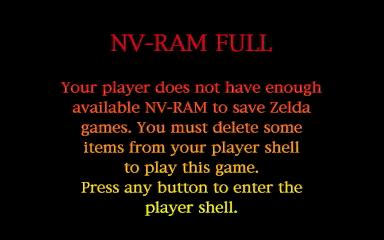

In [92]:
import PIL.Image
import array

QUANT_TABLE = [
          0,   1,   4,   9,
         16,  27,  44,  79,
        128, 177, 212, 229,
        240, 247, 252, 255
    ]

def to_yuv422p(data, width, height, startValues):
    # Adapted from https://github.com/roysmeding/cditools/blob/rewrite/cdi/formats/dyuv.py#L28
    Y = array.array('B', (0 for _ in range(width * height     )))
    U = array.array('B', (0 for _ in range(width * height // 2)))
    V = array.array('B', (0 for _ in range(width * height // 2)))

    for y in range(height):
        Yprev, Uprev, Vprev = startValues

        for x in range(0, width, 2):
            idx = y * width + x
            B0, B1 = struct.unpack('BB', data[idx:idx + 2])

            dU, dY0 = (B0 & 0xF0) >> 4, B0 & 0x0F
            dV, dY1 = (B1 & 0xF0) >> 4, B1 & 0x0F

            Yprev = (Yprev + QUANT_TABLE[dY0]) & 0xFF
            Y[idx] = Yprev

            Yprev = (Yprev + QUANT_TABLE[dY1]) & 0xFF
            Y[idx + 1] = Yprev

            Uprev = (Uprev + QUANT_TABLE[dU ]) & 0xFF
            U[idx // 2] = Uprev

            Vprev = (Vprev + QUANT_TABLE[dV ]) & 0xFF
            V[idx // 2] = Vprev
    return Y, U, V

def to_yuv444p(data, width, height, startValues):
    Y, U, V = to_yuv422p(data, width, height, startValues)

    Uout = array.array('B', (0 for _ in range(width * height)))
    Vout = array.array('B', (0 for _ in range(width * height)))

    for y in range(height):
        for x in range(0, width, 2):
            idx = y * width + x

            Uout[idx] = U[idx // 2]
            if x < width - 2:
                Uout[idx + 1] = (U[idx // 2] + U[(idx // 2) + 1]) // 2
            else:
                Uout[idx + 1] =  U[idx // 2]

            Vout[idx] = V[idx // 2]
            if x < width - 2:
                Vout[idx + 1] = (V[idx // 2] + V[(idx // 2) + 1]) // 2
            else:
                Vout[idx + 1] =  V[idx // 2]

    return Y, Uout, Vout
    
def dyuvToRGB(data, width, height, startValues):
    Y, U, V = to_yuv444p(data, width, height, startValues)
    # def to_pil(self):
    def _interleave():
        for i in range(len(Y)):
            yield Y[i]
            yield U[i]
            yield V[i]

    return PIL.Image.frombytes('YCbCr', (width, height), bytes(_interleave())).convert('RGB')

# Sane defaults
def dyuvToRGBBackground(data):
    return dyuvToRGB(data, 384, 240, (0x80, 0x80, 0x80))

dyuvToRGB(parsedMapres.subFiles["nvr"].getBytes(), 384, 240, (0x80, 0x80, 0x80))

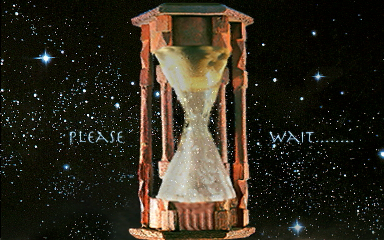

In [170]:
dyuvToRGBBackground(parsedMapres.subFiles["zws"].getBytes())

Clut size: 256 colors


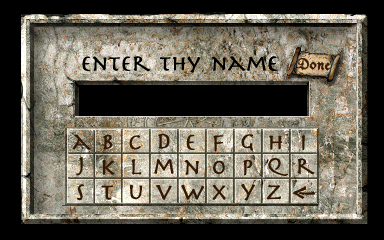

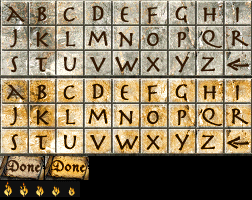

In [47]:
def getClut(data):
    stream = StructStream(data, endianPrefix=">")
    size = stream.take("I")
    print("Clut size:", size, "colors")
    return stream.takeRaw(size * 3)

def clut8ToRGB(data, width, height, palette):
    image = PIL.Image.frombytes("P", (width, height), data)
    image.putpalette(palette)
    return image
    
clut = getClut(parsedMapres.subFiles["ent"].getBytes(kind="data"))
#display(clut8ToRGB(parsedMapres.subFiles["ent"].getBytes(0, 40, kind="video"), 384, 240, clut))
#display(clut8ToRGB(parsedMapres.subFiles["ent"].getBytes(40, 62, kind="video"), 252, 200, clut))
#display(clut8ToRGB(parsedMapres.subFiles["entl"].getBytes(kind="video"), 524, 16, clut))
display(clut8ToRGB(parsedMapres.subFiles["ent"].getRecord(0, "video"), 384, 240, clut))
display(clut8ToRGB(parsedMapres.subFiles["ent"].getRecord(1, "video"), 252, 200, clut))
display(clut8ToRGB(parsedMapres.subFiles["entl"].getRecord(0, "video"), 524, 16, clut))

Clut size: 128 colors


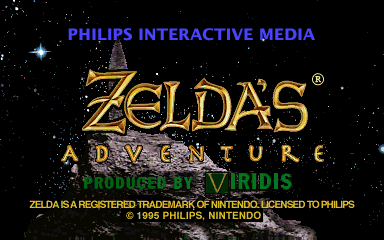

In [171]:
clut = getClut(parsedMapres.subFiles["dtc"].getRecord(0, "data"))
display(clut8ToRGB(parsedMapres.subFiles["dtc"].getRecord(0, "video"), 384, 240, clut))

In [71]:
class ButtonData:
    def __init__(self, stream):
        # Header
        self.flags, self.unk_0x2 = stream.take("IH")
        self.xMin, self.yMin, self.xMax, self.yMax = stream.take("HHHH")
        assert stream.take("I") == 0, "onCollision_maybe pointer"
        self.nextOffset, self.unkOffset = stream.take("ii")
        assert stream.take("I") == 0, "pointerListeners_maybe pointer"
        
        # Callbacks
        callbacks = stream.takeRaw(8 * 7)
        assert list(callbacks) == [0] * (8 * 7), callbacks
        
        self.textureWidth, self.textureHeight = stream.take("HH")
        
        # UV Coordinates
        def readUVCoord(stream):
            y, x = stream.take("hh")
            if y == -1:
                return None
            if x == -1:
                return "transparent"
            return {"x": x, "y": y}
        
        self.normalUV = readUVCoord(stream)
        self.hoverUV = readUVCoord(stream)
        self.hoverFirstFrameUV = readUVCoord(stream)
        self.unkStateUV = readUVCoord(stream)
        self.textureCoords = readUVCoord(stream)
        assert self.textureCoords != "transparent"
        
        assert stream.take("II") == (0, 0), "atlas and destSprite pointers"
        
        self.unk_0x76, self.startState = stream.take("HH")
        assert len(stream) == 0, stream
        
        
uiDataRaw = parsedMapres.subFiles["ent"].getRecord(1, "data")
uiData = ResourceTree.parseFromStream(StructStream(uiDataRaw, endianPrefix=">"))
uiData.__dict__
buttons = [ButtonData(e.copy()).__dict__ for e in uiData.children["keys"].elements]
buttons

root 3 20 70
list 3 20 32 0
Next element offset 6
Next element offset 12
Next offset is unknown. Using rest of buffer 6
Mismatched set node size; expected 38 found 50
	without data part: 50
list 3 20 32 70
Next element offset 3436
Next element offset 3752
Next offset is unknown. Using rest of buffer 60
Mismatched set node size; expected 3832 found 32
	without data part: 3844


[{'flags': 0,
  'unk_0x2': 0,
  'xMin': 580,
  'yMin': 108,
  'xMax': 666,
  'yMax': 154,
  'nextOffset': 1,
  'unkOffset': -1,
  'textureWidth': 86,
  'textureHeight': 46,
  'normalUV': {'x': 312, 'y': 0},
  'hoverUV': {'x': 312, 'y': 90},
  'hoverFirstFrameUV': None,
  'unkStateUV': None,
  'textureCoords': {'x': 108, 'y': 580},
  'unk_0x76': 0,
  'startState': 0},
 {'flags': 0,
  'unk_0x2': 0,
  'xMin': 582,
  'yMin': 356,
  'xMax': 638,
  'yMax': 404,
  'nextOffset': 2,
  'unkOffset': -1,
  'textureWidth': 56,
  'textureHeight': 48,
  'normalUV': {'x': 102, 'y': 450},
  'hoverUV': {'x': 256, 'y': 450},
  'hoverFirstFrameUV': None,
  'unkStateUV': None,
  'textureCoords': {'x': 356, 'y': 582},
  'unk_0x76': 0,
  'startState': 0},
 {'flags': 0,
  'unk_0x2': 0,
  'xMin': 134,
  'yMin': 258,
  'xMax': 190,
  'yMax': 306,
  'nextOffset': 3,
  'unkOffset': -1,
  'textureWidth': 56,
  'textureHeight': 48,
  'normalUV': {'x': 2, 'y': 2},
  'hoverUV': {'x': 156, 'y': 2},
  'hoverFirstFrameU

Clut size: 256 colors


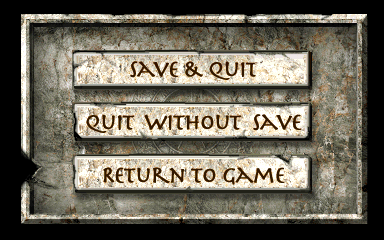

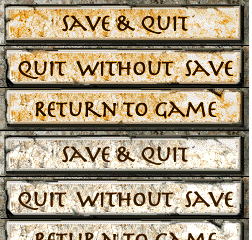

root 1 20 52
list 1 20 24 0
Next offset is unknown. Using rest of buffer 8
Mismatched set node size; expected 28 found 32
	without data part: 32
list 1 20 24 52
Next offset is unknown. Using rest of buffer 386
Mismatched set node size; expected 406 found 24
	without data part: 410


[{'flags': 0,
  'unk_0x2': 0,
  'xMin': 136,
  'yMin': 92,
  'xMax': 634,
  'yMax': 182,
  'nextOffset': 1,
  'unkOffset': -1,
  'textureWidth': 498,
  'textureHeight': 90,
  'normalUV': {'x': 262, 'y': 0},
  'hoverUV': {'x': 0, 'y': 0},
  'hoverFirstFrameUV': None,
  'unkStateUV': None,
  'textureCoords': {'x': 92, 'y': 136},
  'unk_0x76': 0,
  'startState': 0},
 {'flags': 0,
  'unk_0x2': 0,
  'xMin': 136,
  'yMin': 200,
  'xMax': 634,
  'yMax': 282,
  'nextOffset': 2,
  'unkOffset': -1,
  'textureWidth': 498,
  'textureHeight': 82,
  'normalUV': {'x': 354, 'y': 0},
  'hoverUV': {'x': 92, 'y': 0},
  'hoverFirstFrameUV': None,
  'unkStateUV': None,
  'textureCoords': {'x': 200, 'y': 136},
  'unk_0x76': 0,
  'startState': 0},
 {'flags': 0,
  'unk_0x2': 0,
  'xMin': 136,
  'yMin': 308,
  'xMax': 634,
  'yMax': 388,
  'nextOffset': -1,
  'unkOffset': -1,
  'textureWidth': 498,
  'textureHeight': 80,
  'normalUV': {'x': 438, 'y': 0},
  'hoverUV': {'x': 176, 'y': 0},
  'hoverFirstFrameUV': 

In [72]:
clut = getClut(parsedMapres.subFiles["opt"].getRecord(0, "data"))
display(clut8ToRGB(parsedMapres.subFiles["opt"].getRecord(0, "video"), 384, 240, clut))
display(clut8ToRGB(parsedMapres.subFiles["opt"].getRecord(1, "video"), 0xfc, 240, clut))
uiDataRaw = parsedMapres.subFiles["opt"].getRecord(1, "data")
uiData = ResourceTree.parseFromStream(StructStream(uiDataRaw, endianPrefix=">"))
buttons = [ButtonData(e.copy()).__dict__ for e in uiData.children["buttons"].elements]
buttons

In [1]:
display(dyuvToRGB(zeldaRlDir.subFiles["vb1"].getRecord(1, "video"), 384, 240, (0x80, 0x80, 0x80)))
display(dyuvToRGB(zeldaRlDir.subFiles["vb1"].getRecord(2, "video"), 384, 240, (0x80, 0x80, 0x80)))
display(dyuvToRGB(zeldaRlDir.subFiles["vb1"].getRecord(3, "video"), 384, 240, (0x80, 0x80, 0x80)))
display(dyuvToRGB(zeldaRlDir.subFiles["vb1l"].getRecord(0, "video"), 384, 240, (0x80, 0x80, 0x80)))

NameError: name 'dyuvToRGB' is not defined

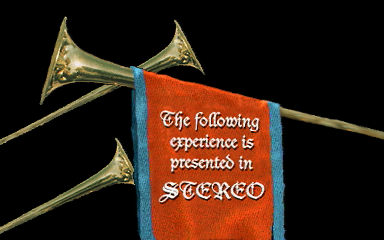

In [23]:
dyuvToRGB(zeldaRlDir.subFiles["str"].getRecord(0, "video"), 384, 240, (0x80, 0x80, 0x80))

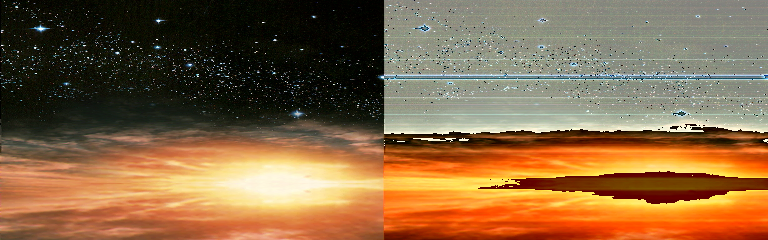

In [24]:
display(dyuvToRGB(zeldaRlDir.subFiles["cast"].getRecord(1, "video"), 384*2, 240, (0x80, 0x80, 0x80)))

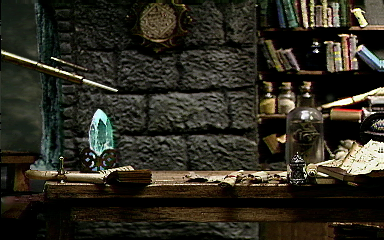

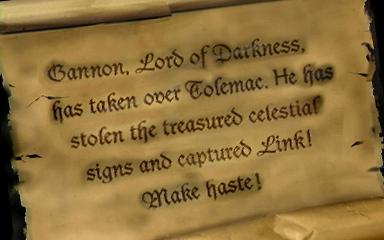

In [25]:
display(dyuvToRGB(zeldaRlDir.subFiles["zi1_i"].getRecord(1, "video"), 384, 240, (0x80, 0x80, 0x80)))
display(dyuvToRGB(zeldaRlDir.subFiles["zi1_i"].getRecord(2, "video"), 384, 240, (0x80, 0x80, 0x80)))

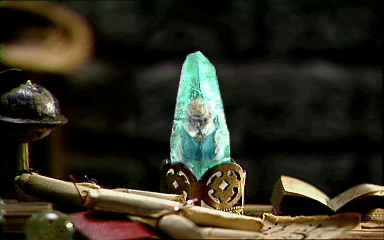

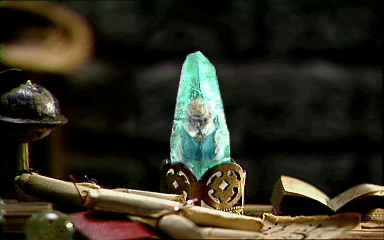

In [26]:
display(dyuvToRGB(zeldaRlDir.subFiles["zi3_i"].getRecord(1, kind="video"), 384, 240, (0x80, 0x80, 0x80)))
display(dyuvToRGB(zeldaRlDir.subFiles["zi3_i"].getRecord(2, kind="video"), 384, 240, (0x80, 0x80, 0x80)))

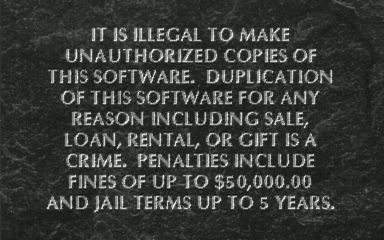

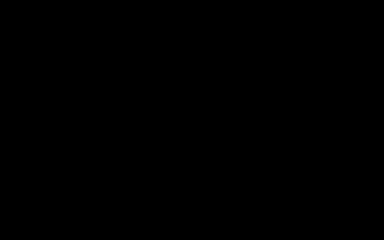

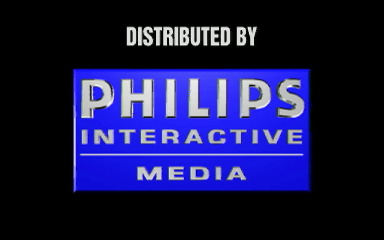

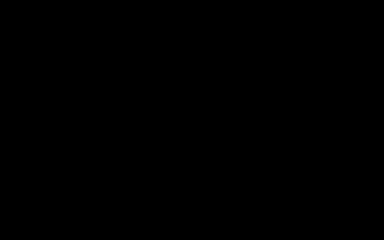

In [27]:
for i in range(4):
    display(dyuvToRGB(zeldaRlDir.subFiles["legal"].getRecord(i, "video"), 384, 240, (0x80, 0x80, 0x80)))


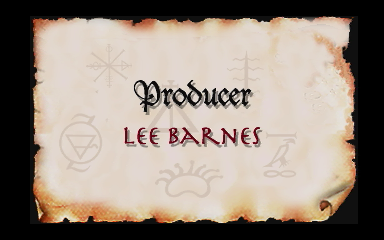

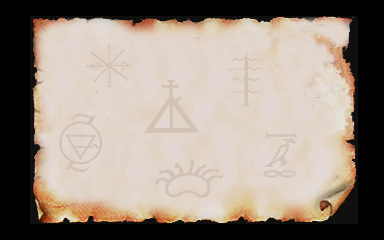

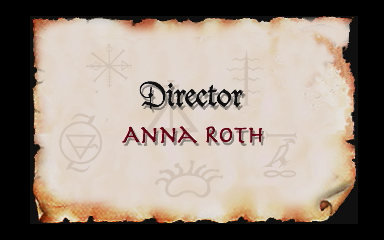

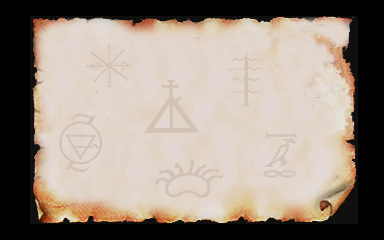

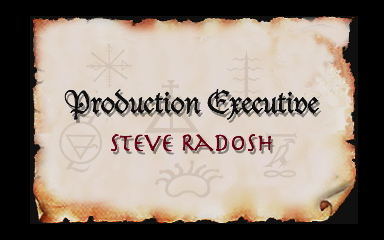

...

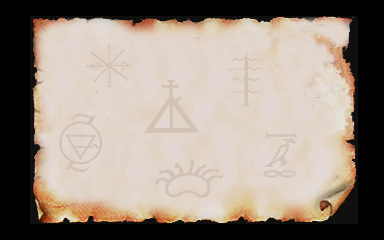

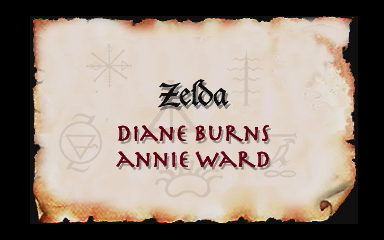

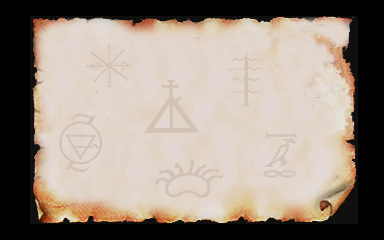

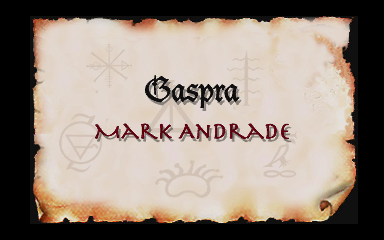

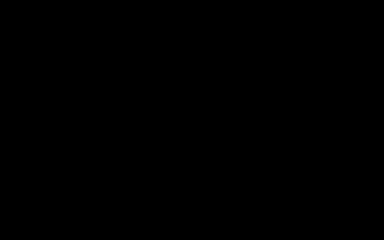

In [28]:
for i in range(len(zeldaRlDir.subFiles["cred"].videoSizes)):
    display(dyuvToRGB(zeldaRlDir.subFiles["cred"].getRecord(i, "video"), 384, 240, (0x80, 0x80, 0x80)))

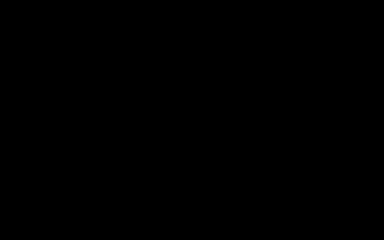

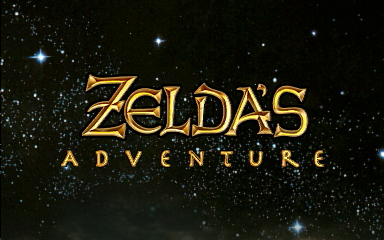

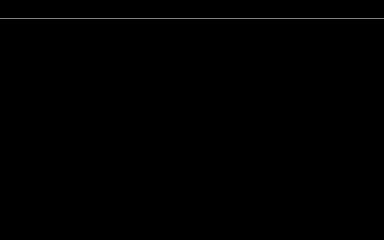

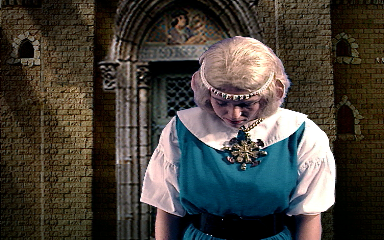

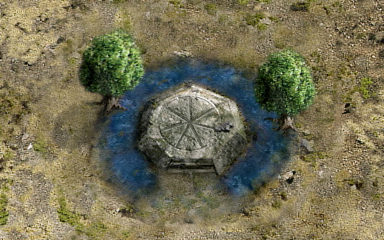

...

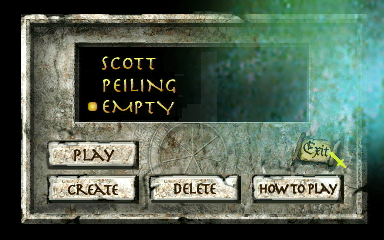

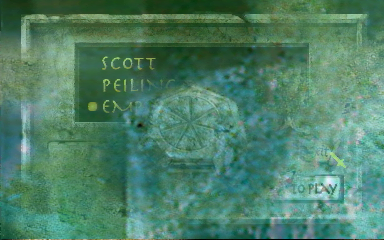

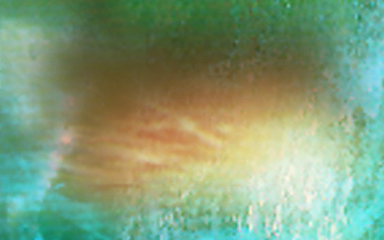

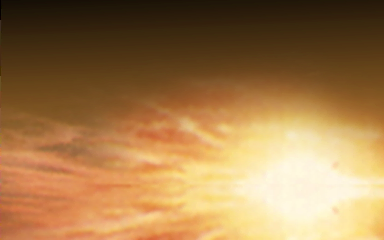

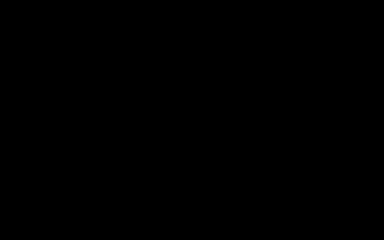

In [29]:
for i in range(len(zeldaRlDir.subFiles["how"].videoSizes)):
    display(dyuvToRGB(zeldaRlDir.subFiles["how"].getRecord(i, "video"), 384, 240, (0x80, 0x80, 0x80)))

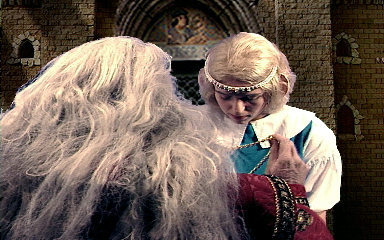

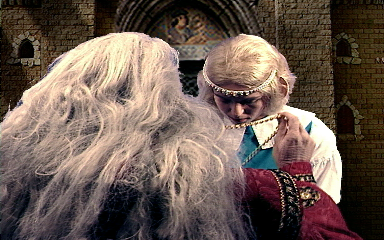

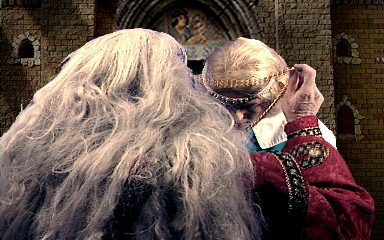

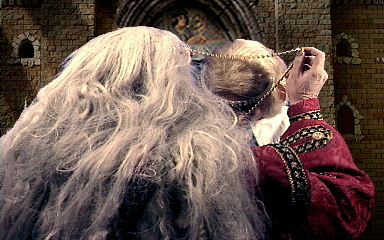

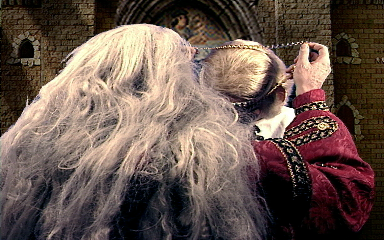

...

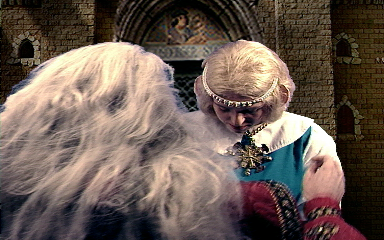

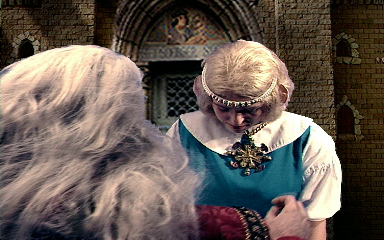

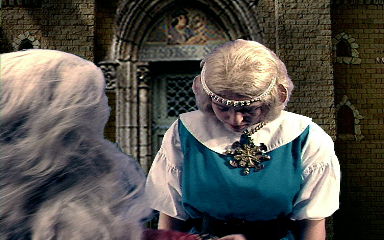

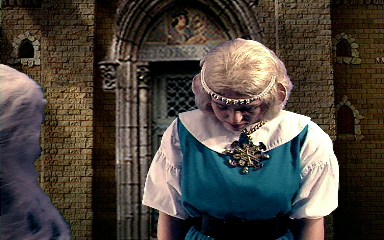

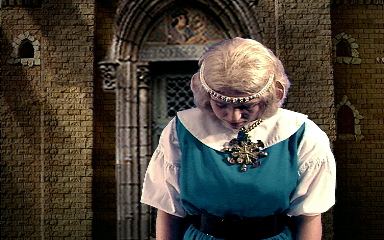

In [30]:
for i in range(len(zeldaRlDir.subFiles["zi2"].videoSizes)):
    display(dyuvToRGB(zeldaRlDir.subFiles["zi2"].getRecord(i, "video"), 384, 240, (0x80, 0x80, 0x80)))

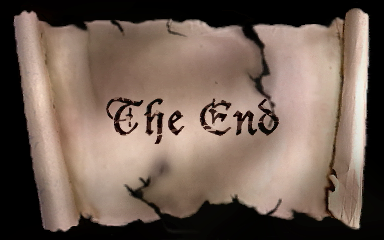

In [31]:
for i in range(len(zeldaRlDir.subFiles["gan5"].videoSizes)):
    display(dyuvToRGB(zeldaRlDir.subFiles["gan5"].getRecord(i, "video"), 384, 240, (0x80, 0x80, 0x80)))

In [82]:
def zeldaRng(state):
    state = state * 0x4b05731 + 1
    state = state & 0xFFFF
    return state

def zeldaRngStats(state, iterCount):
    bitStats = [0] * 16
    def getBitStats(state):
        for i in range(16):
            if state & (1 << i) != 0:
                bitStats[i] += 1
    
    getBitStats(state)
    for i in range(iterCount):
        state = zeldaRng(state)
        getBitStats(state)
    
    for i in range(16):
        bitStats[i] /= iterCount
    return bitStats

zeldaRngStats(0x1, 2000000)

[0.5000005,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.500001,
 0.500001,
 0.5000005,
 0.4999995,
 0.499999,
 0.499997,
 0.499991,
 0.5000095,
 0.4999955]

Loading from overworld
root 5 20 90
list 5 20 40 90
Next element offset 30
Next element offset 54
Next element offset 80
Next element offset 110
Next offset is unknown. Using rest of buffer 100
Mismatched set node size; expected 230 found 40
	without data part: 250
list 1 20 24 0
Next offset is unknown. Using rest of buffer 6
Mismatched set node size; expected 26 found 30
	without data part: 30
list 5 20 40 0
Next element offset 6
Next element offset 12
Next element offset 18
Next element offset 24
Next offset is unknown. Using rest of buffer 6
Mismatched set node size; expected 50 found 70
	without data part: 70
root 3 20 78
list 3 20 32 78
Next element offset 66
Next element offset 374
Next offset is unknown. Using rest of buffer 290
Mismatched set node size; expected 684 found 32
	without data part: 696
list 3 20 32 0
Next element offset 8
Next element offset 18
Next offset is unknown. Using rest of buffer 8
Mismatched set node size; expected 46 found 58
	without data part: 58
root 

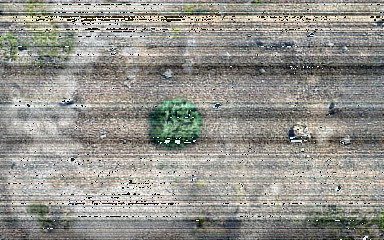

{'_subfile': <__main__.ParsedMapresFileEntry at 0x22018550d30>,
 'bgImage': <PIL.Image.Image image mode=RGB size=384x240 at 0x220197560B8>,
 'info': {'unk0': 1, 'hasSpData': True, 'unk4': False},
 'descriptions': [<__main__.CellDescription at 0x220197876d8>],
 'cast': [<__main__.CellCast at 0x220197877b8>,
 'unkData': <__main__.ResourceTreeNode at 0x220197879e8>,
 'saveData': []}

In [168]:
class Cell:
    def __init__(self, subfile):
        self._subfile = subfile
        self.bgImage = dyuvToRGBBackground(subfile.getRecord(0, "video"))
        r2 = ResourceTree.parseFromStream(StructStream(subfile.getRecord(2, "data"), endianPrefix=">"))
        r4 = ResourceTree.parseFromStream(StructStream(subfile.getRecord(4, "data"), endianPrefix=">"))
        r5 = ResourceTree.parseFromStream(StructStream(subfile.getRecord(5, "data"), endianPrefix=">"))
        r6 = ResourceTree.parseFromStream(StructStream(subfile.getRecord(6, "data"), endianPrefix=">"))
        
        infoParts = r2.children["info"].elements[0].peek("HHH")
        self.info = { "unk0": infoParts[0], "hasSpData": infoParts[1] != 0, "unk4": infoParts[2] != 0}
        
        rawDescriptions = r4.children["sp_desc"].elements
        rawGroups = r4.children["sp_groups"].elements
        rawTrees = r6.children
        rawCast = r4.children["sp_cast"].elements
        if "sp_vector" in r4.children:
            rawVectors = r4.children["sp_vector"].elements
            rawTable = [s.peek("H") for s in r4.children["sp_table"].elements]
        else:
            rawVectors = []
            rawTable = []
        
        groupIndex = 0
        self.descriptions = []
        for i in range(len(rawDescriptions)):
            desc = CellDescription(rawDescriptions[i].copy(), rawTrees[i])
            desc.groups = rawGroups[groupIndex:groupIndex + desc.groupCount]
            groupIndex += desc.groupCount
            self.descriptions.append(desc)
        
        vectorIndex = 0
        tableIndex = 0
        self.cast = []
        for i in range(len(rawCast)):
            cast = CellCast(rawCast[i].copy())
            cast.desc = self.descriptions[cast.descId]
            if cast.type in [1, 6, 7]:
                cast.vector = CellVector(rawVectors[vectorIndex].copy())
                cast.vector.table = rawTable[tableIndex:tableIndex + cast.vector.tableSize]
                vectorIndex += 1
                tableIndex += cast.vector.tableSize
            elif cast.type == 5:
                cast.kpInit = r4.children["kp_init"]
                cast.wpCmds = r4.children["wp_cmds"]
            self.cast.append(cast)
        
        
        self.unkData = rawTrees[len(rawDescriptions)]
        saveDataParent = rawTrees[len(rawDescriptions) + 1]
        saveDataArray = saveDataParent.children[0]
        assert saveDataArray.elementSize == 2
        self.saveData = [s.copy().take("H") for s in saveDataArray.elements]

class CellDescription:
    def __init__(self, stream, tree):
        assert len(stream) == 46, len(stream)
        self.coordsMaybe, self.groupCount = stream.take("IH")
        pointer = stream.take("I")
        assert pointer == 0, pointer
        
        self.rest = stream
        
        self.groups = None
        self.tree = tree

class CellCast:
    def __init__(self, stream):
        assert len(stream) == 54, len(stream)
        pointers = stream.takeRaw(24)
        assert pointers == b'\0' * 24, pointers
        
        self.unk24, self.type, self.unk28, self.descId = stream.take("HHBB")
        self.unk30, self.unk32, self.unk34, self.unk36 = stream.take("HHHI")
        self.unk40, self.unk42, self.coords = stream.take("HHI")
        
        self.rest = stream
        self.vector = None
        self.kpInit = None
        self.wpCmds = None
    
class CellVector:
    def __init__(self, stream):
        assert len(stream) == 14, len(stream)
        self.unk0, self.tableSize, self.unk6, pointer = stream.take("IHII")
        assert pointer == 0, pointer
        self.table = None

def extractCell(name, parsedDir = None):
    if not parsedDir:
        if name in overDir.subFiles:
            if name in underDir.subFiles:
                print("Warning: cell exists in both overworld and underworld")
            print("Loading from overworld")
            cellFile = overDir.subFiles[name]
        elif name in underDir.subFiles:
            print("Loading from underworld")
            cellFile = underDir.subFiles[name]
        else:
            print("Could not find cell", name)
            return
    else:
        cellFile = parsedDir.subFiles[name]
    
    cell = Cell(cellFile)
    display(cell.bgImage)
    """display(dyuvToRGBBackground(cell.getRecord(0, "video")))
    r2 = ResourceTree.parseFromStream(StructStream(cell.getRecord(2, "data"), endianPrefix=">"))
    r4 = ResourceTree.parseFromStream(StructStream(cell.getRecord(4, "data"), endianPrefix=">"))
    r6 = ResourceTree.parseFromStream(StructStream(cell.getRecord(6, "data"), endianPrefix=">"))
    
    infoParts = r2.children["info"].elements[0].peek("HHH")
    info = { "unk0": infoParts[0], "unk2": infoParts[1] != 0, "unk4": infoParts[2] != 0}
    print(info)
    
    print([(n, r2.children[n].__dict__) for n in r2.children])
    print(repr(r4.__dict__))"""
    return cell

cell = extractCell("i24")
cell.__dict__

In [166]:
cell.cast[0].__dict__

{'unk24': 0,
 'type': 2,
 'unk28': 0,
 'descId': 0,
 'unk30': 210,
 'unk32': 79,
 'unk34': 60,
 'unk36': 0,
 'unk40': 0,
 'unk42': 0,
 'coords': 0,
 'rest': StructStream(b'\x00\x00\x00\x00\x00\x00', cursor=48, endianPrefix=>),
 'vector': None,
 'desc': <__main__.CellDescription at 0x22018757828>}

In [129]:
cell = overDir.subFiles["g23"]
r2 = ResourceTree.parseFromStream(StructStream(cell.getRecord(2, "data"), endianPrefix=">"))
r4 = ResourceTree.parseFromStream(StructStream(cell.getRecord(4, "data"), endianPrefix=">"))
r6 = ResourceTree.parseFromStream(StructStream(cell.getRecord(6, "data"), endianPrefix=">"))

r6.children[1].children[0].__dict__

root 5 20 90
list 5 20 40 90
Next element offset 30
Next element offset 54
Next element offset 80
Next element offset 130
Next offset is unknown. Using rest of buffer 100
Mismatched set node size; expected 250 found 40
	without data part: 270
list 1 20 24 0
Next offset is unknown. Using rest of buffer 6
Mismatched set node size; expected 26 found 30
	without data part: 30
list 5 20 40 0
Next element offset 6
Next element offset 12
Next element offset 18
Next element offset 24
Next offset is unknown. Using rest of buffer 6
Mismatched set node size; expected 50 found 70
	without data part: 70
root 3 20 78
list 3 20 32 78
Next element offset 20
Next element offset 40
Next offset is unknown. Using rest of buffer 20
Mismatched set node size; expected 80 found 32
	without data part: 92
list 3 20 32 0
Next element offset 8
Next element offset 18
Next offset is unknown. Using rest of buffer 8
Mismatched set node size; expected 46 found 58
	without data part: 58
root 3 0 20
list 3 20 32 20
Next

{'tag': 1, 'size': 20, 'elementCount': 0, 'elementSize': 2, 'elements': []}